# Modelo de Regresión Lineal

In [1]:
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
import sklearn
import re
import seaborn as sns

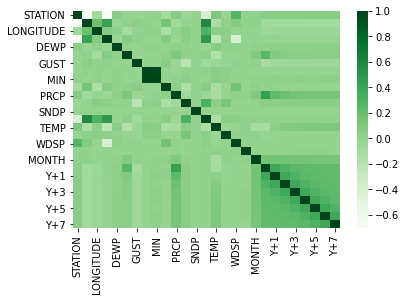

In [2]:
df = pd.read_csv("compiled_raw_y.csv")
sns.heatmap(df.corr(), cmap="Greens")
df = df.drop(columns=['Y','Y+1','Y+2','Y+3','Y+4','Y+5','Y+6','Y+7'])
df = df[df['FRSHTT'].apply(lambda x: len(str(x)) == 5)]

df['FOG'] = df.FRSHTT.apply(lambda x: int(str(x)[0]))
df['RAIN'] = df.FRSHTT.apply(lambda x: int(str(x)[1]))
df['SNOW'] = df.FRSHTT.apply(lambda x: int(str(x)[2]))
df['HAIL'] = df.FRSHTT.apply(lambda x: int(str(x)[3]))
df['TT'] = df.FRSHTT.apply(lambda x: int(str(x)[4]))

#una vez separada la columna, no es necesaria tenerla
#todos los valores de fog son iguales por lo que no aporta nada al modelo
df= df.drop(columns=['STATION', 'DATE', 'LATITUDE', 'LONGITUDE', 'NAME', 'WEEKDAY', 'PRCP', 'GUST', 'FRSHTT', 'FOG'])
df.reset_index(drop=True, inplace=True)

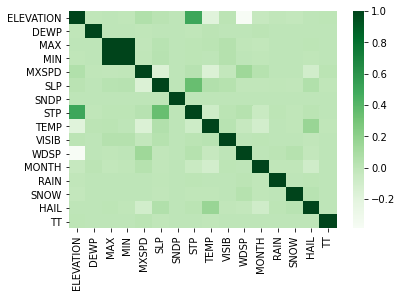

In [3]:
sns.heatmap(df.corr(), cmap="Greens")
plt.savefig('heatmap.jpg')

Como resultado, se ve una correlación levemente positiva en los datos, visualmente pasando a más de 0 aproximadamente con todas las variables revisadas. Creamos un modelo lineal con las 17 variables capaz de predecir los granizos, aunque no será muy certero dado que la mayoría de los datos tienden a cero.

Para entrenar el modelo de regresión lineal, se crea el X y el Y de la función Y = wX + b. La variable Y será precio. Las variables X serán el resto menos, aquí todas las columnas pueden ser utilizadas dado que todas son de tipo numérico.

# Predicción general

In [4]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import classification_report

In [5]:
X = df[['ELEVATION', 'DEWP', 'MAX', 'MIN', 'MXSPD', 'SLP', 'SNDP', 'STP', 'VISIB', 'WDSP', 'SNOW', 'TEMP', 'TT']]
y = df['HAIL']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.55, random_state=101)
lm = LinearRegression()
lm.fit(X_train,y_train)


LinearRegression()

In [11]:
print(lm.intercept_)

-0.3388278878011184


Separamos los datos de entrenamiento, validación y test.

- Tomamos 55% de los datos para entrenamiento
- Tomamos 45% de los datos para testeo
- Controlamos la mezcla (random_state) aplicada a los datos antes de la división. Reproducimos 101 veces el mismo conjunto de puntos de datos de prueba y entrenamiento, cada vez que se realiza una división.

Luego de crear el modelo, la variable "lm" ahora tiene el modelo entrenado para ver los coeficientes y calcular qué tan bueno es prediciendo los granizos.

Evaluamos el modelo revisando el b de la función y = wX + b

In [6]:
coeff_df = pd.DataFrame(lm.coef_,X.columns,columns=['Coefficient'])
coeff_df

,Coefficient
ELEVATION,-8.558159e-06
DEWP,4.087698e-05
MAX,2.808994e-02
MIN,-2.807910e-02
MXSPD,-9.654382e-05
SLP,1.195509e-05
SNDP,-1.023487e-16
STP,-1.471166e-05
VISIB,-6.114082e-04
WDSP,-4.455477e-05


Interpretando los coeficientes:

- Manteniendo todo fijo y aumentando 1 unidad de ELEVATION lo asociaremos a un decremento de -7.494784e-06
- Manteniendo todo fijo y aumentando 1 unidad de DEWP lo asociaremos a un incremento de 3.249300e-05
- Manteniendo todo fijo y aumentando 1 unidad de MAX lo asociaremos a un incremento de 2.728319e-02
- Manteniendo todo fijo y aumentando 1 unidad de MIN lo asociaremos a un decremento de -2.726363e-02
- Manteniendo todo fijo y aumentando 1 unidad de MXSPD lo asociaremos a un decremento de -9.336097e-05
- Manteniendo todo fijo y aumentando 1 unidad de SLP lo asociaremos a un incremento de 1.161432e-05
- Manteniendo todo fijo y aumentando 1 unidad de SNDP lo asociaremos a un decremento de -3.022756e-16
- Manteniendo todo fijo y aumentando 1 unidad de STP lo asociaremos a un decremento de -1.465305e-05
- Manteniendo todo fijo y aumentando 1 unidad de VISIB lo asociaremos a un decremento de -6.126214e-04
- Manteniendo todo fijo y aumentando 1 unidad de WDSP lo asociaremos a un decremento de -6.693304e-05
- Manteniendo todo fijo y aumentando 1 unidad de MONTH lo asociaremos a un decremento de -4.050129e-03
- Manteniendo todo fijo y aumentando 1 unidad de SNOW lo asociaremos a un incremento de 3.530088e-01
- Manteniendo todo fijo y aumentando 1 unidad de TEMP lo asociaremos a un incremento de 3.363138e-03
- Manteniendo todo fijo y aumentando 1 unidad de TT lo asociaremos a un decremento de 6.584252e-02

Luego aplicamos predicciones para el modelo creado anteriormente.

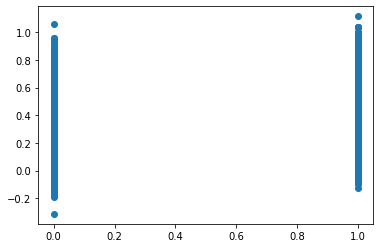

In [7]:
predictions = lm.predict(X_test)
plt.scatter(y_test,predictions)

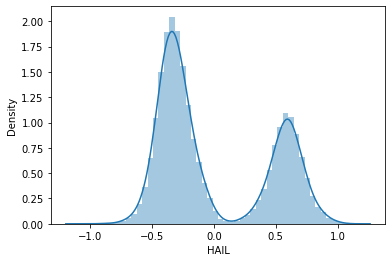

In [8]:
sns.distplot((y_test-predictions),bins=50);

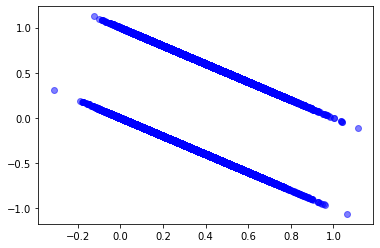

In [9]:
plt.scatter(predictions,y_test-predictions,c='blue',alpha=0.5)

In [10]:
from sklearn import metrics
print('MAE:', metrics.mean_absolute_error(y_test, predictions))
print('MSE:', metrics.mean_squared_error(y_test, predictions))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predictions)))
print('R2:', metrics.r2_score(y_test,predictions))

MAE: 0.4168748566377764
MSE: 0.20813458131568593
RMSE: 0.4562176907088171
R2: 0.08526864115686816


# Predicción Mensual

In [12]:
def monthly_linear_regression(dataframe):
    df_headers = ['ELEVATION', 'DEWP', 'MAX', 'MIN', 'MXSPD', 'SLP', 'SNDP', 'STP', 'VISIB', 'WDSP', 'SNOW', 'TEMP', 'TT']
    df_final = pd.DataFrame(df_headers, columns = ["DATA"])
    for i in range(12):
        df2 = dataframe.copy()
        df2 = df2[df2['MONTH'] == (i+1)]
        X = df2[df_headers]
        y = df2['HAIL']

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.55, random_state=101)
        lm = LinearRegression()
        lm.fit(X_train,y_train)

        df_coefficients = pd.DataFrame(lm.coef_,X.columns,columns=['Coefficient'])
        monthly_coef = []
        for j in range(len(df_coefficients)):
            monthly_coef.append(df_coefficients['Coefficient'][j])
        month_name = 'MONTH '+ str(i+1)
        df_final[month_name] = pd.Series(monthly_coef).values

    print(df_final)

monthly_linear_regression(df)

         DATA       MONTH 1       MONTH 2       MONTH 3       MONTH 4  \
0   ELEVATION  6.443924e-07  7.780182e-04  2.326513e-04  9.510218e-05   
1        DEWP  2.986236e-02  9.881456e-03  2.995884e-02  2.835415e-02   
2         MAX  1.377706e-02  4.082011e-02  4.412728e-02  4.331344e-02   
3         MIN -1.379742e-02  2.963646e-02  6.193923e-03 -1.707251e-02   
4       MXSPD -8.478062e-05 -1.882753e-04 -1.608599e-04 -1.307501e-04   
5         SLP  1.022962e-05  4.580725e-06  1.352982e-05  1.536531e-05   
6        SNDP  1.821460e-16  6.938894e-18 -2.775558e-17 -1.387779e-17   
7         STP  1.595603e-06  5.518440e-05  1.917469e-05  1.984875e-05   
8       VISIB -2.674117e-02 -6.248109e-02 -4.552731e-04 -2.585224e-02   
9        WDSP -4.461245e-05  2.149281e-04  2.996772e-04  1.189092e-05   
10       SNOW  0.000000e+00  4.490373e-01  3.229867e-01  1.481539e-01   
11       TEMP -2.267725e-02 -5.623349e-02 -6.280613e-02 -4.256733e-02   
12         TT  0.000000e+00  0.000000e+00  0.000000